# Check Turublent Flux Calculations
### Author: Daniel Hogan & Eli Schwat
### Created: October 24, 2024
This notebook will use the turbulent flux corrections including the SND (Schotanus, P., F.T.M. Nieuwstadt, and H.A.R. DeBruin, 1983) sonoic temperature correction and the WPL (Webb) correction for correcting for the vertical flux of water vapor. The krypton oxygen absorption correction is not calculated. Corrections follow the [ISFS NCAR guide](https://www.eol.ucar.edu/content/corrections-sensible-and-latent-heat-flux-measurements).

# Imports

In [1]:

# data 
import xarray as xr 
import numpy as np
import pandas as pd
from scipy import stats as stats 
from sublimpy import utils 
# plotting
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import cufflinks as cf
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.io as pio
# helper tools
import scripts.helper_funcs as hf
from metpy import calc, units
from metpy import constants as mpconsts
# make plotly work 
init_notebook_mode(connected=True)
cf.go_offline()

# Correction Functions

### Sonic Temperature correction or SND correction.

Sonic (speed of sound) temperature is equal to $T_c = T(1+0.51Q)$ where $T$ is the absoulte temperature (units?? likely Kelvin) and $Q$ is specific humidity. Thus,
$$<w't'> = <w't_c'> - 0.51T <w'q'>$$
Here $T$ will be the temperature taken at the same position on the C tower. 

### WPL (Webb) Correction
Both Krypton and IR-absorption (ours) hygrometers measure water vapor density, $h_2o$. However, Webb et al (1980) show that vertical flux of water vapor density is not equal to $w'h_2o'$, but rather:
$$E = \rho_d <w'mr'>$$
$$ = \rho_a <w'q'>/(1-Q)$$
$$ = (1+\mu \times MR)[<w'h_2o'> + (\rho_v/T)<w't'>]$$
where,  $\rho_a$ and $\rho_v$ are the densities of (moist) air and water vapor, MR and mr' are the mean value and fluctuations of mixing ratio, Q and q' are the mean value and fluctuations of specific humidity, and $\mu=M_d/M_w=1/0.622$ is the ratio of the molecular weights of dry air and water vapor

### Sensible and Latent Heat Flux Calculations
The sensible and latent heat fluxes can be calculated from the basic measurements of $<w'tc'>$ and $<w'kh_2o'>$ by solving the preceding set of equations for $<w't'>$ and $<w'mr'>$.
$$<w't'> = [<w't_c'> - C_{tc}(T/\rho_a)A <w'kh_2o'>] / [1+C_{tc}(Q+C_{ko}(1-Q))]$$
$$<w'mr'> = (1+\mu*MR)[(A/\rho_d)<w'kh_2o'> + ((C_{ko}+MR)/T)<w't_c'>] / [1 + C_{tc}(Q + C_{ko}(1-Q))]$$
As noted previously, IR-absorption hygrometers are insensitive to oxygen absorption, so that $Cko=0$ and $<w'kh_2o'>=<w'h_2o'>$. Additionally, without separation between sonic and irga measurements, A is equal to 1 (assumption here). So this simplifies to:
$$<w't'> = [<w't_c'> - C_{tc}(T/\rho_a)<w'h_2o'>] / [1+C_{tc}(Q)]$$
$$<w'mr'> = (1+\mu \times MR)[(1/\rho_d)<w'h_2o'> + (MR/T)<w't_c'>] / [1 + C_{tc}\times Q]$$
where,
$$C_{tc} = 0.51[1+Q(\mu - 1)]$$

In [2]:
rho_d = 1293*units.units('g/m^3') # density of dry air at 
rho_a = 1287*units.units('g/m^3') #density of moist air
rho_v = 600*units.units('g/m^3') #density of water vapor
mu = 1/0.622
rho_w = mpconsts.density_water

def corrected_sensible_heat_flux(
    w_tc_, #sonic_temperature_flux
    w_h2o_, #h2o_flux
    Q, #specific_humidity
    T, #absolute_temperature
    A, #A, assuming this is equal to 1
    rho_a, #density of moist air
):
    # ensure units are set correctly for w_tc_ and w_h2o_
    
    Ctc = 0.51*(1 + Q*(mu-1))
    part1 = w_tc_ - Ctc*(T/rho_a)*A*w_h2o_
    part2 = 1 + Ctc*Q
    return part1 / part2

def corrected_latent_heat_flux(
    w_tc_, #sonic_temperature_flux
    w_h2o_, #h2o_flux
    Q, #specific_humidity
    T, #absolute_temperature
    A, #A, assuming this is equal to 1
    Mr, #mean_mixing_ratio
    rho_d, #density of dry air
):
    Ctc = 0.51*(1 + Q*(mu-1))
    return (1 + mu*Mr)* (
        (A/rho_d)*w_h2o_ + (Mr/T)*(w_tc_)
    ) / (
        1 + Ctc*Q
    )

def wpl_corrected_latent_heat_flux(
    w_t, #corrected sonic_temperature_flux
    w_h2o_, #h2o_flux
    Q, #specific_humidity
    T, #absolute_temperature
    A, #A
    Mr, #mean_mixing_ratio
    rho_v, #density of water vapor
    rho_d, #density of dry air
):
    return (
        1 + mu*Mr
    )*(
        w_h2o_ + (rho_v/T)*w_t
    )/rho_d

# Data

In [3]:
# load in the sos data
sos_30min = xr.open_dataset('../../01_data/processed_data/sos/sos_ds_5min_storage.nc')

# Data Preparation

In [11]:
sos_30min_RH = sos_30min[[var for var in hf.TEMPERATURE_VARIABLES if 'RH' in var]] 
sos_30min_T = sos_30min[[var for var in hf.TEMPERATURE_VARIABLES if 'T' in var]] * units.units('degC')
# turbulent fluxes
sos_30min_w_h2o= sos_30min[[var for var in hf.TURBULENCE_VARIABLES if 'w_h2o_' in var]] * units.units('g/m^3 m/s')
sos_30min_w_tc = sos_30min[[var for var in hf.TURBULENCE_VARIABLES if 'w_tc_' in var]] * units.units('K m/s')
sos_30min_h2o = sos_30min[[var for var in hf.WATER_VAPOR_VARIABLES if 'h2o_' in var]] * units.units('g/m^3')

# calculate pressure, mixing ratio and air density
heights = np.arange(2,21,1)
pressureprofiles = []
mixingratios = []
specifichumidities = []
airdensities_moist = []
airdensities_dry = []
vaporpressures = []
vapordensities = []
temperatures = []
thetas = []
for h in heights:
    # calculate pressure
    pressure = calc.height_to_pressure_std(
                                calc.pressure_to_height_std(sos_30min['P_10m_c']*units.units('hPa')) - ((10 - h)/1000)*units.units('km'))
    pressure.name = f'P_{h}m_c'
    # calculate mixing ratio
    mixingratio = calc.mixing_ratio_from_relative_humidity(pressure, sos_30min_T[f'T_{h}m_c'], sos_30min_RH[f'RH_{h}m_c']).metpy.convert_units('g/kg')
    mixingratio.name=f'w_{h}m_c'
    # calculate specific humidity
    specifichumidity = calc.specific_humidity_from_mixing_ratio(mixingratio).metpy.convert_units('g/kg')
    specifichumidity.name = f'Q_{h}m_c'
    # calculate air density of moist air
    airdensity_moist = calc.density(pressure, sos_30min_T[f'T_{h}m_c'], mixingratio).metpy.convert_units('kg/m^3')
    airdensity_moist.name = f'rho_a_{h}m_c'
    # calculate air density of dry air
    airdensity_dry = calc.density(pressure, sos_30min_T[f'T_{h}m_c'], mixingratio*0).metpy.convert_units('kg/m^3')
    airdensity_dry.name = f'rho_d_{h}m_c'
    # calculate vapor pressure
    vaporpressure = calc.vapor_pressure(pressure, mixingratio).metpy.convert_units('Pa')
    vaporpressure.name = f'e_{h}m_c'
    # get temperatures
    temperature = sos_30min_T[f'T_{h}m_c'].metpy.convert_units('K')
    temperature.name = f'T_{h}m_c'
    # calculate vapor density
    R = 8.314 * units.units('m^3 Pa/K/mol') / (18.015 * units.units('g/mol'))
    vapordensity = vaporpressure / (temperature.metpy.convert_units('K') * R)
    vapordensity.name = f'rho_v_{h}m_c'
    # calculate potential temperature
    theta = calc.potential_temperature(pressure, sos_30min_T[f'T_{h}m_c'])
    theta.name = f'Theta_{h}m_c'

    # append to lists
    pressureprofiles.append(pressure)
    mixingratios.append(mixingratio)
    specifichumidities.append(specifichumidity)
    airdensities_moist.append(airdensity_moist)
    airdensities_dry.append(airdensity_dry)
    vaporpressures.append(vaporpressure)
    vapordensities.append(vapordensity)
    temperatures.append(temperature)
    thetas.append(theta)


# Create xarray datasets
sos_30min_pressure_profiles = xr.merge(pressureprofiles)
sos_30min_mixing_ratio = xr.merge(mixingratios)
sos_30min_specific_humidity = xr.merge(specifichumidities)
sos_30min_airdensity_moist = xr.merge(airdensities_moist) 
sos_30min_airdensity_dry = xr.merge(airdensities_dry)
sos_30min_vaporpressure = xr.merge(vaporpressures) 
sos_30min_vapor_density = xr.merge(vapordensities)
sos_30min_temperatures = xr.merge(temperatures)
sos_30min_theta = xr.merge(thetas) 

In [13]:
height = 5
w_t_corrected = corrected_sensible_heat_flux(w_tc_=sos_30min_w_tc[f'w_tc__{height}m_c'],
                             w_h2o_=sos_30min_w_h2o[f'w_h2o__{height}m_c'],
                             Q=sos_30min_specific_humidity[f'Q_{height}m_c'],
                             T=sos_30min_temperatures[f'T_{height}m_c'],
                             A=1,
                             rho_a=sos_30min_airdensity_moist[f'rho_a_{height}m_c']
                            )
w_mr_corrected = corrected_latent_heat_flux(w_tc_=sos_30min_w_tc[f'w_tc__{height}m_c'],
                                            w_h2o_=sos_30min_w_h2o[f'w_h2o__{height}m_c'],
                                            Q=sos_30min_specific_humidity[f'Q_{height}m_c'],
                                            T=sos_30min_temperatures[f'T_{height}m_c'],
                                            A=1,
                                            Mr=sos_30min_mixing_ratio[f'w_{height}m_c'],
                                            rho_d=sos_30min_airdensity_dry[f'rho_d_{height}m_c']
                                            )
w_mr_wpl_corrected = wpl_corrected_latent_heat_flux(w_t=w_t_corrected,
                                            w_h2o_=sos_30min_w_h2o[f'w_h2o__{height}m_c'],
                                            Q=sos_30min_specific_humidity[f'Q_{height}m_c'], # g_wv/kg_air
                                            T=sos_30min_temperatures[f'T_{height}m_c'], # K
                                            A=1,
                                            Mr=sos_30min_mixing_ratio[f'w_{height}m_c'], # g_wv/kg_dry
                                            rho_v=sos_30min_h2o[f'h2o_{height}m_c'], # kg/m^3
                                            rho_d=sos_30min_airdensity_dry[f'rho_d_{height}m_c'] # kg/m^3
                                            )

In [14]:
# convert to latent heat flux
latent_heat_sublimation = 2.835e6 * units.units('J/kg') # latent heat of sublimation J/kg
# heat_capacity_air units J/kg/C
heat_capacity_air = (1005)*units.units('J/kg/K') # J/kg/C
def calc_latent_heat_flux(w_h2o, latent_heat_sublimation, rho_a=None):
    if rho_a is not None:
        return w_h2o * latent_heat_sublimation * rho_a * (1/1000)*units.units('kg/g')
    else:
        return w_h2o * latent_heat_sublimation * (1/1000)*units.units('kg/g')
def calc_sensible_heat_flux(w_tc, rho_a):
    return heat_capacity_air * w_tc * rho_a

# Calculate latent heat fluxes
Hl_corrected = calc_latent_heat_flux(w_mr_corrected, latent_heat_sublimation, sos_30min_airdensity_moist['rho_a_10m_c'])
Hl_wpl_corrected = calc_latent_heat_flux(w_mr_wpl_corrected, latent_heat_sublimation, sos_30min_airdensity_moist['rho_a_10m_c'])
Hl_raw = calc_latent_heat_flux(sos_30min_w_h2o['w_h2o__10m_c'], latent_heat_sublimation)

# Calculate sensible heat fluxes
Hs_corrected = calc_sensible_heat_flux(w_t_corrected, sos_30min_airdensity_moist['rho_a_10m_c'])
Hs_raw = calc_sensible_heat_flux(sos_30min_w_tc['w_tc__10m_c'], sos_30min_airdensity_moist['rho_a_10m_c'])

### Question: How should we handle when we are missing these data, it does fill in some values if those are desired?
I think this method will fill in for values where we have w't' but don't have w'h2o'. 

In [15]:
fig = go.Figure()
# fig.add_trace(go.Scatter(x=sos_30min.time, y=Hs_corrected, mode='lines', name='Hs_corrected'))
fig.add_trace(go.Scatter(x=sos_30min.time, y=Hl_raw, mode='lines', name='Hl_RAW'))
fig.add_trace(go.Scatter(x=sos_30min.time, y=Hl_wpl_corrected, mode='lines', name='Hl_wpl_corrected'))
fig.add_trace(go.Scatter(x=sos_30min.time, y=Hl_corrected, mode='lines', name='Hl_corrected'))
fig.update_layout(title='Corrected latent heat flux', xaxis_title='Time', yaxis_title="Latent Heat Flux (W/m^2)", height=800, width=800)

Text(0, 0.5, 'wpl_corrected (g/m2/s)')

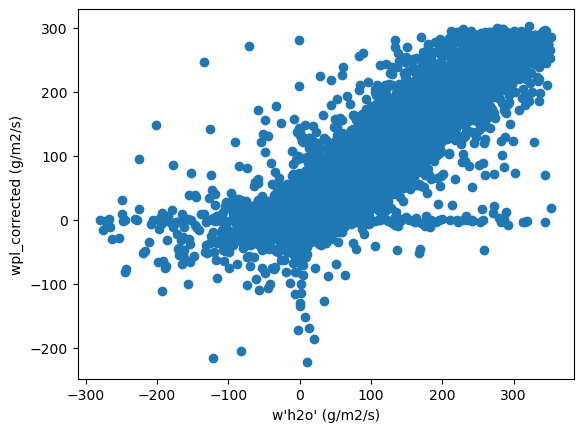

In [20]:
fig, ax = plt.subplots()
ax.scatter(Hl_raw, Hl_corrected)
ax.set_xlabel("w'h2o' (g/m2/s)")
ax.set_ylabel("wpl_corrected (g/m2/s)")


In [17]:
fig = go.Figure()
# fig.add_trace(go.Scatter(x=sos_30min.time, y=Hs_corrected, mode='lines', name='Hs_corrected'))
fig.add_trace(go.Scatter(x=sos_30min.time, y=sos_30min_w_tc[f'w_tc__{height}m_c'], mode='lines', name='Hs_RAW'))
fig.add_trace(go.Scatter(x=sos_30min.time, y=w_t_corrected, mode='lines', name='Hs_corrected'))
fig.update_layout(title='Corrected sensible heat flux', xaxis_title='Time', yaxis_title="<w't'>", height=800, width=800)

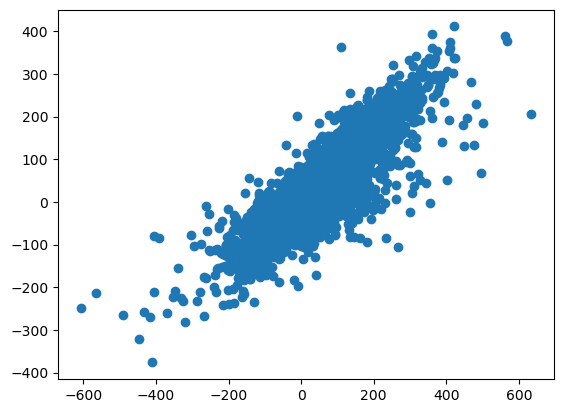

In [19]:
fig, ax = plt.subplots()
ax.scatter(Hs_raw, Hs_corrected)
# ax.plot([-100, 100], [-100, 100], color='red')?